In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [4]:
df = pd.read_csv(r'C:\Users\Right Click\Desktop\ml_2\DataSet\Agrofood_co2_emission.csv')

In [5]:
df.shape

(6965, 31)

In [6]:
df.head()

,Area,Year,Savanna fires,Forest fires,Crop Residues,Rice Cultivation,Drained organic soils (CO2),Pesticides Manufacturing,Food Transport,Forestland,...,Manure Management,Fires in organic soils,Fires in humid tropical forests,On-farm energy use,Rural population,Urban population,Total Population - Male,Total Population - Female,total_emission,Average Temperature °C
0,Afghanistan,1990,14.7237,0.0557,205.6077,686.00,0.0,11.807483,63.1152,-2388.803,...,319.1763,0.0,0.0,NaN,9655167.0,2593947.0,5348387.0,5346409.0,2198.963539,0.536167
1,Afghanistan,1991,14.7237,0.0557,209.4971,678.16,0.0,11.712073,61.2125,-2388.803,...,342.3079,0.0,0.0,NaN,10230490.0,2763167.0,5372959.0,5372208.0,2323.876629,0.020667
2,Afghanistan,1992,14.7237,0.0557,196.5341,686.00,0.0,11.712073,53.3170,-2388.803,...,349.1224,0.0,0.0,NaN,10995568.0,2985663.0,6028494.0,6028939.0,2356.304229,-0.259583
3,Afghanistan,1993,14.7237,0.0557,230.8175,686.00,0.0,11.712073,54.3617,-2388.803,...,352.2947,0.0,0.0,NaN,11858090.0,3237009.0,7003641.0,7000119.0,2368.470529,0.101917
4,Afghanistan,1994,14.7237,0.0557,242.0494,705.60,0.0,11.712073,53.9874,-2388.803,...,367.6784,0.0,0.0,NaN,12690115.0,3482604.0,7733458.0,7722096.0,2500.768729,0.372250


In [7]:
df.columns

Index(['Area', 'Year', 'Savanna fires', 'Forest fires', 'Crop Residues',
       'Rice Cultivation', 'Drained organic soils (CO2)',
       'Pesticides Manufacturing', 'Food Transport', 'Forestland',
       'Net Forest conversion', 'Food Household Consumption', 'Food Retail',
       'On-farm Electricity Use', 'Food Packaging',
       'Agrifood Systems Waste Disposal', 'Food Processing',
       'Fertilizers Manufacturing', 'IPPU', 'Manure applied to Soils',
       'Manure left on Pasture', 'Manure Management', 'Fires in organic soils',
       'Fires in humid tropical forests', 'On-farm energy use',
       'Rural population', 'Urban population', 'Total Population - Male',
       'Total Population - Female', 'total_emission',
       'Average Temperature °C'],
      dtype='object')

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6965 entries, 0 to 6964
Data columns (total 31 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Area                             6965 non-null   object 
 1   Year                             6965 non-null   int64  
 2   Savanna fires                    6934 non-null   float64
 3   Forest fires                     6872 non-null   float64
 4   Crop Residues                    5576 non-null   float64
 5   Rice Cultivation                 6965 non-null   float64
 6   Drained organic soils (CO2)      6965 non-null   float64
 7   Pesticides Manufacturing         6965 non-null   float64
 8   Food Transport                   6965 non-null   float64
 9   Forestland                       6472 non-null   float64
 10  Net Forest conversion            6472 non-null   float64
 11  Food Household Consumption       6492 non-null   float64
 12  Food Retail         

find categorical variables

In [9]:
categorical = [var for var in df.columns if df[var].dtype=='O']

print('There are {} categorical variables\n'.format(len(categorical)))

print('The categorical variables are :', categorical)

There are 1 categorical variables

The categorical variables are : ['Area']


find numerical variables

In [10]:
numerical = [var for var in df.columns if df[var].dtype!='O']

print('There are {} numerical variables\n'.format(len(numerical)))

print('The numerical variables are :', numerical)

There are 30 numerical variables

The numerical variables are : ['Year', 'Savanna fires', 'Forest fires', 'Crop Residues', 'Rice Cultivation', 'Drained organic soils (CO2)', 'Pesticides Manufacturing', 'Food Transport', 'Forestland', 'Net Forest conversion', 'Food Household Consumption', 'Food Retail', 'On-farm Electricity Use', 'Food Packaging', 'Agrifood Systems Waste Disposal', 'Food Processing', 'Fertilizers Manufacturing', 'IPPU', 'Manure applied to Soils', 'Manure left on Pasture', 'Manure Management', 'Fires in organic soils', 'Fires in humid tropical forests', 'On-farm energy use', 'Rural population', 'Urban population', 'Total Population - Male', 'Total Population - Female', 'total_emission', 'Average Temperature °C']


Summary statistics

In [11]:
summary_statis = df.describe().T
summary_statis[['mean', 'std', 'min', '25%', '50%', '75%', 'max']]

,mean,std,min,25%,50%,75%,max
Year,2.005125e+03,8.894665e+00,1990.000000,1997.000000,2.005000e+03,2.013000e+03,2.020000e+03
Savanna fires,1.188391e+03,5.246288e+03,0.000000,0.000000,1.651850e+00,1.110814e+02,1.146164e+05
Forest fires,9.193022e+02,3.720079e+03,0.000000,0.000000,5.179000e-01,6.495077e+01,5.222763e+04
Crop Residues,9.987063e+02,3.700345e+03,0.000200,11.006525,1.036982e+02,3.776410e+02,3.349007e+04
Rice Cultivation,4.259667e+03,1.761383e+04,0.000000,181.260800,5.348174e+02,1.536640e+03,1.649153e+05
Drained organic soils (CO2),3.503229e+03,1.586145e+04,0.000000,0.000000,0.000000e+00,6.904088e+02,2.410251e+05
Pesticides Manufacturing,3.334184e+02,1.429159e+03,0.000000,6.000000,1.300000e+01,1.163255e+02,1.645900e+04
Food Transport,1.939582e+03,5.616749e+03,0.000100,27.958600,2.049628e+02,1.207001e+03,6.794576e+04
Forestland,-1.782829e+04,8.183221e+04,-797183.079000,-2848.350000,-6.292000e+01,0.000000e+00,1.711211e+05
Net Forest conversion,1.760564e+04,1.011575e+05,0.000000,0.000000,4.444000e+01,4.701746e+03,1.605106e+06


 Check Outliers For Total Emission

In [12]:
fig = px.box(df, y='total_emission',
             title='CO2 Emissions Distribution with Outliers',
             labels={'total_emission': 'CO2 Emissions (kt)'})
fig.show()


Correlation Heatmap
To see linear relationships between numeric features.

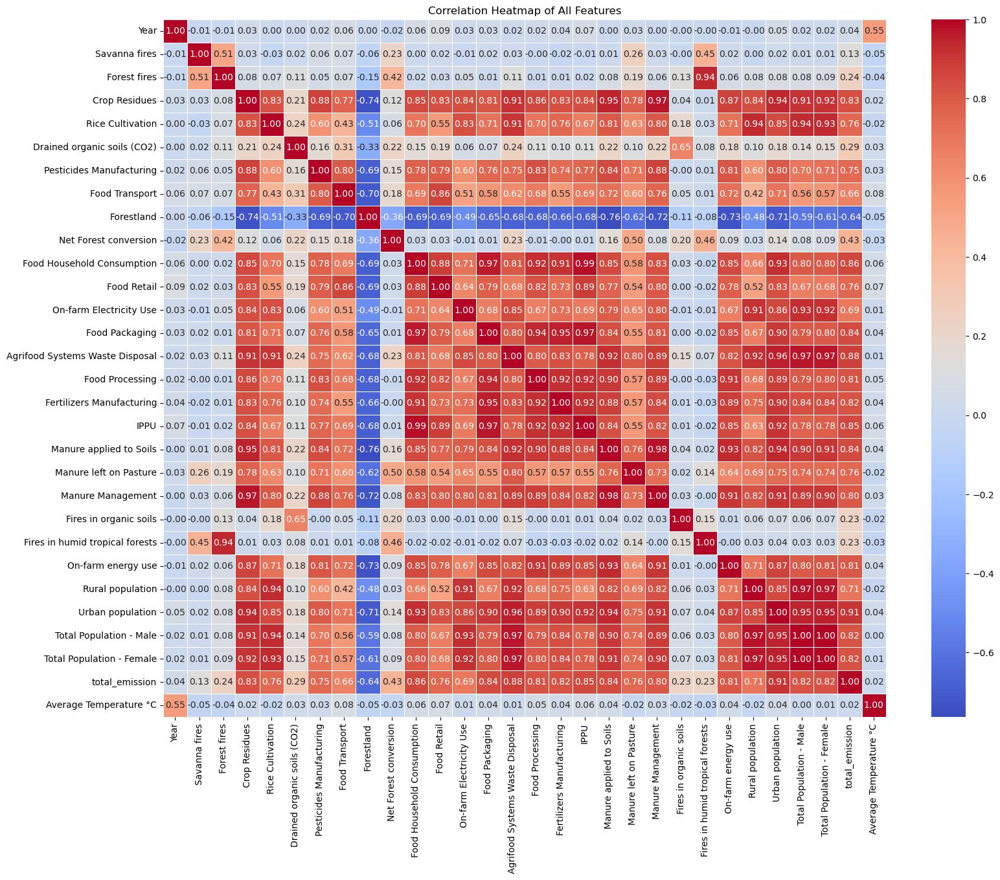

In [14]:
plt.figure(figsize=(18, 14))
sns.heatmap(df.select_dtypes(include='number').corr(), cmap='coolwarm', annot=True, fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap of All Features')
plt.show()


Top Correlated Features with Total Emissions

In [15]:
target = 'total_emission'
correlations = df.corr(numeric_only=True)[target].drop(target).sort_values()

cor_df = correlations.reset_index()
cor_df.columns = ['Feature', 'Correlation']

fig = px.bar(cor_df,
             x='Correlation',
             y='Feature',
             orientation='h',
             color='Correlation',
             color_continuous_scale='sunset',
             title=" Features Correlated with Total Emissions ",
             hover_data=['Feature', 'Correlation'])

fig.update_layout(height=600)
fig.show()

In [16]:
features = ['Rice Cultivation', 'Food Transport', 'Fertilizers Manufacturing', 'Average Temperature °C']

# Create scatter plots for each feature against 'total_emission'
for feature in features:
    # Scatter plot for the current feature against 'total_emission'
    fig = px.scatter(df, x=feature, y='total_emission', color=feature,
                     title=f'{feature} vs Total Emission',
                     labels={feature: feature, 'total_emission': 'Total Emission'})
    fig.show()

# Distribution plots

In [17]:
import plotly.express as px

fig = px.histogram(df, x='Food Processing',y='Food Packaging', nbins=30, 
                   title='Distribution of processing to food packeging',
                   labels={'Food Packaging': 'Food Packaging',
                           'Food Processing':'Food Processing'})
fig.show()

In [18]:
features = ['Rice Cultivation', 'Food Transport', 'Fertilizers Manufacturing', 'Average Temperature °C']

# Create distribution plots for each feature
for feature in features:
    # Create a histogram for the current feature
    fig = px.histogram(df, x=feature, nbins=30, title=f'Distribution of {feature}',
                       labels={feature: feature})
    fig.show()

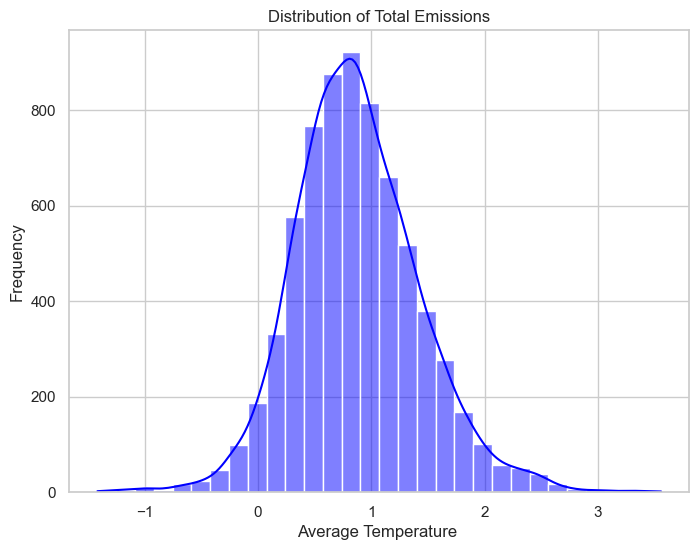

In [19]:

# Distribution plot for total_emission
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.histplot(df['Average Temperature °C'], kde=True, color='blue', bins=30)

plt.title('Distribution of Total Emissions')
plt.xlabel('Average Temperature ')
plt.ylabel('Frequency')
plt.show()

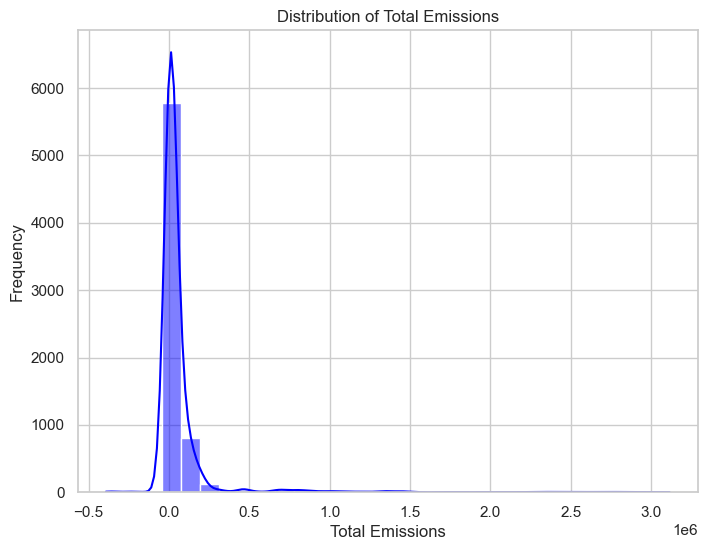

In [20]:
# Distribution plot for total_emission
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.histplot(df['total_emission'], kde=True, color='blue', bins=30)

plt.title('Distribution of Total Emissions')
plt.xlabel('Total Emissions')
plt.ylabel('Frequency')
plt.show()

In [21]:
# Assuming 'year' is a column representing time in the dataset
fig = px.scatter(df, x='Year', y='total_emission', title='Total Emissions Over Time')

fig.update_layout(title='Trend of Total Emissions Over Time', xaxis_title='Year', yaxis_title='Total Emissions')
fig.show()

In [22]:
fig = px.scatter(df,  x='Year',  y='Average Temperature °C', title='Trend of Average Temperature Over Time') 
fig.update_layout(title='Trend of Average Temperature Over Time',xaxis_title='Year',yaxis_title='Average Temperature (°C)', 
    hovermode='x unified')
fig.show()



In [23]:
df['Area'].nunique()

236

Map

In [24]:
df['abs_emission'] = df['total_emission'].abs()

fig = px.scatter_geo(df,
                     locations="Area",
                     locationmode="country names",
                     size="abs_emission",
                     color="total_emission",  # still shows actual (even negatives)
                     projection="natural earth",
                     animation_frame="Year",
                     title="Total Emission per Area (Bubble size = magnitude)")
fig.show()


Comparison of CO2 Emissions: Urban vs Rural

In [25]:
# Calculate Urban and Rural emissions
df['Urban emission'] = df['total_emission'] * (df['Urban population'] / (df['Urban population'] + df['Rural population']))
df['Rural emission'] = df['total_emission'] * (df['Rural population'] / (df['Urban population'] + df['Rural population']))

fig = px.scatter(df,
                 x='Urban emission',
                 y='Rural emission',
                 title="Comparison of CO2 Emissions: Urban vs Rural",
                 labels={'Urban emission': 'Urban Emissions (kt)', 'Rural emission': 'Rural Emissions (kt)'},
                 hover_data=['Year', 'Area', 'total_emission', 'Urban population', 'Rural population'])

fig.show()


Direct Emission Sources (Highly Relevant)

In [26]:
columns_of_interest = [
    "Savanna fires",
    "Forest fires",
    "Crop Residues",
    "Rice Cultivation",
    "Drained organic soils (CO2)",
    "Manure applied to Soils",
    "Manure left on Pasture",
    "Manure Management",
    "Fires in organic soils",
    "Fires in humid tropical forests"
]


Scatter Plots with total_emission (relationship check)

In [31]:
fig = px.scatter(df, x='Drained organic soils (CO2)', y='total_emission',
                 title='Drained organic soils (CO2) vs Total Emission',
                 labels={'Drained organic soils (CO2)': 'Drained organic soils (CO2)', 'total_emission': 'Total Emission'},
                 trendline='ols', template='plotly_white')
fig.show()


In [32]:
fig = px.scatter(df, x='Manure applied to Soils', y='total_emission',
                 title='Manure applied to Soils vs Total Emission',
                 labels={'Manure applied to Soils': 'Manure applied to Soils', 'total_emission': 'Total Emission'},
                 trendline='ols', template='plotly_white')
fig.show()


In [33]:
fig = px.scatter(df, x='Manure left on Pasture', y='total_emission',
                 title='Manure left on Pasture vs Total Emission',
                 labels={'Manure left on Pasture': 'Manure left on Pasture', 'total_emission': 'Total Emission'},
                 trendline='ols', template='plotly_white')
fig.show()


In [34]:
fig = px.scatter(df, x='Manure Management', y='total_emission',
                 title='Manure Management vs Total Emission',
                 labels={'Manure Management': 'Manure Management', 'total_emission': 'Total Emission'},
                 trendline='ols', template='plotly_white')
fig.show()


In [35]:
fig = px.scatter(df, x='Fires in organic soils', y='total_emission',
                 title='Fires in organic soils vs Total Emission',
                 labels={'Fires in organic soils': 'Fires in organic soils', 'total_emission': 'Total Emission'},
                 trendline='ols', template='plotly_white')
fig.show()


In [36]:
fig = px.scatter(df, x='Fires in humid tropical forests', y='total_emission',
                 title='Fires in humid tropical forests vs Total Emission',
                 labels={'Fires in humid tropical forests': 'Fires in humid tropical forests', 'total_emission': 'Total Emission'},
                 trendline='ols', template='plotly_white')
fig.show()


To Check Outliers

In [41]:
import plotly.figure_factory as ff
import numpy as np

for col in columns_of_interest[:-1]:
    cleaned_data = df[col].replace([np.inf, -np.inf], np.nan).dropna()
    
    if cleaned_data.empty:
        print(f"Skipping {col}: all values are NaN or infinite.")
        continue

    hist_data = [cleaned_data]
    group_labels = [col]

    fig = ff.create_distplot(hist_data, group_labels, show_hist=False, show_rug=False)
    fig.update_layout(title_text=f'Distribution (KDE) of {col}')
    fig.show()


In [42]:
fig = px.parallel_coordinates(df,
                              dimensions=columns_of_interest,
                              color="total_emission",
                              color_continuous_scale=px.colors.diverging.Tealrose,
                              title='Parallel Coordinates Plot - Feature Relationships')
fig.show()


Histogram for feature distribution

In [43]:
for col in columns_of_interest:
    fig = px.histogram(df, x=col, nbins=50,
                       title=f'Histogram of {col}',
                       marginal="box",  # Adds box plot on side
                       opacity=0.7)
    fig.show()


In [ ]:
fig = px.scatter_3d(df,
                    x='Savanna fires',
                    y='Forest fires',
                    z='total_emission',
                    color='total_emission',
                    title='3D Scatter Plot: Savanna Fires, Forest Fires vs Total Emission')
fig.show()


1- Savanna fires: The correlation between Savanna Fires and Total Emission is weakly positive, This indicates that while there may be a small increase in emissions as savanna fires increase, the effect is not strong enough to be a key driver of total emissions.


2- Forest fires: Forest Fires show a modest positive correlation with total emissions, suggesting that burning forests contributes to greenhouse gases, but may not be the most dominant source in the dataset.


3- Crop Residues: Crop Residues have a strong positive correlation with total emissions. This means that higher levels of crop waste or burning lead to significantly increased emissions, making it an important factor in agricultural GHG outputs.


4- Rice Cultivation: Rice Cultivation is strongly correlated with total emissions. This aligns with the known fact that rice fields release large amounts of methane, a powerful greenhouse gas.


5- Drained organic soils (CO2): Drained organic soils have a moderate positive correlation with emissions. Draining wetlands and organic soils releases trapped CO2 into the atmosphere.


6- Manure applied to Soils: Applying manure to soils shows a strong positive correlation with total emissions. This indicates that manure use is a major source of agricultural emissions, likely due to nitrous oxide release.


7- Manure left on Pasture: Manure left on pasture has a moderate positive impact on emissions. This uncontrolled waste contributes to methane and nitrous oxide emissions.


8- Manure Management: Manure Management is strongly linked to total emissions, suggesting that better handling practices could significantly reduce greenhouse gases.


9- Fires in organic soils: Fires in organic soils show a weak-to-moderate positive correlation with emissions. This means that these fires contribute, but not as dominantly as other sources.


10- Fires in humid tropical forests: This feature has a weak positive correlation with emissions. While it does add to CO₂ output, the effect is relatively limited in the overall picture.



In [44]:
features = [
    'Fertilizers Manufacturing', 'On-farm Electricity Use', 'On-farm energy use',
    'Food Processing', 'Food Packaging', 'Food Transport', 'Food Retail',
    'Food Household Consumption', 'Agrifood Systems Waste Disposal',
    'Pesticides Manufacturing', 'total_emission'
]

df_selected = df[features]

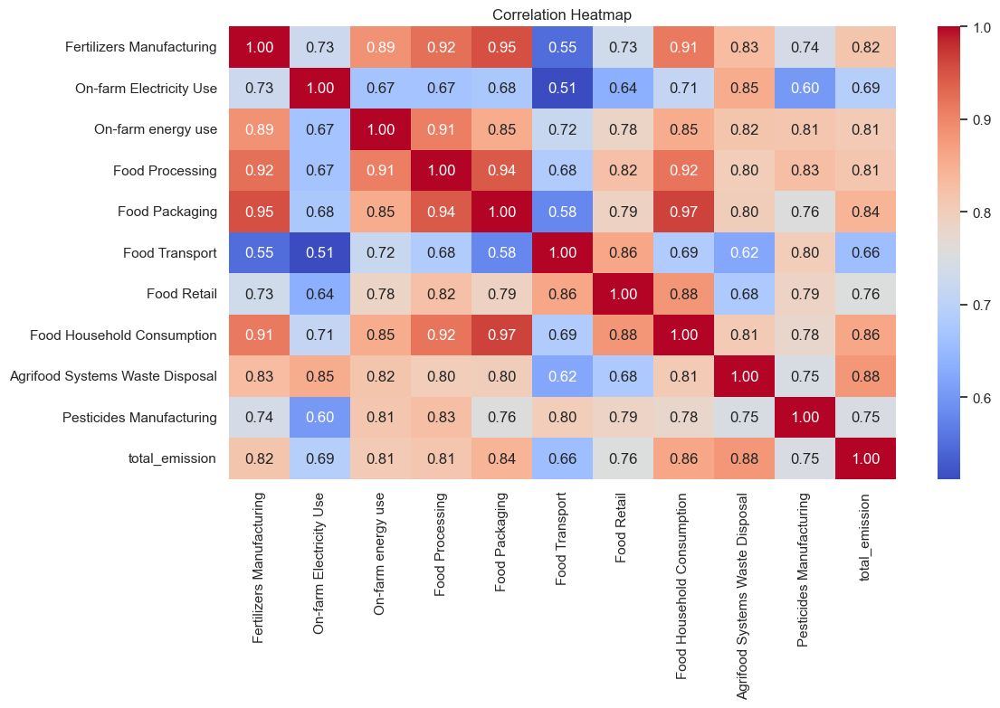

In [45]:
plt.figure(figsize=(12, 8))
sns.heatmap(df_selected.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap')
plt.tight_layout()
plt.show()

piechart shows impact of each feature on total emission 

In [49]:
# Sum emissions from each sector across all rows
emission_contributions = df_selected.drop(columns=['total_emission']).sum().reset_index()
emission_contributions.columns = ['Feature', 'Total_Emission']

# Create Pie Chart
fig = px.pie(emission_contributions, 
             names='Feature', 
             values='Total_Emission',
             title='Contribution of Each Feature to Total Emissions',
             hole=0.3)  # Use hole=0 for full pie or 0.3 for donut

fig.show()